In [1]:
import torch
import sys
import os
import importlib
import yaml

device = 0
config = "cityscapes_linear_semantic.yaml"
root = "/mnt/sda1/tkerssies"

with open(f"configs/{config}", "r") as f:
    config = yaml.safe_load(f)

sys.path.append(os.path.dirname(os.path.abspath("training")))

ckpt_path = (
    "/mnt/sda1/tkerssies/lightning_logs/zyu2bnvv/checkpoints/epoch=39-step=7440.ckpt"
)

lit_module_name, lit_class_name = config["model"]["class_path"].rsplit(".", 1)  # type: ignore
lit_module = getattr(importlib.import_module(lit_module_name), lit_class_name)

network_module_name, network_class_name = config["model"]["init_args"]["network"]["class_path"].rsplit(".", 1)  # type: ignore
network_module = getattr(
    importlib.import_module(network_module_name), network_class_name
)

model = lit_module.load_from_checkpoint(
    ckpt_path, map_location=torch.device(f"cuda:{device}"), num_classes=19
)
model.network.grid_size = model.network.encoder.patch_embed.grid_size

pixel_mean = (
    torch.tensor(model.network.encoder.default_cfg["mean"])
    .reshape(1, -1, 1, 1)
    .to(device)
)
pixel_std = (
    torch.tensor(model.network.encoder.default_cfg["std"])
    .reshape(1, -1, 1, 1)
    .to(device)
)

model.network.register_buffer("pixel_mean", pixel_mean)
model.network.register_buffer("pixel_std", pixel_std)

if type(model.img_size) == int:
    model.img_size = (model.img_size, model.img_size)

/home/tkerssies/miniconda3/envs/benchmark-vfm-ss/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/tkerssies/miniconda3/envs/benchmark-vfm-ss/lib/python3.10/site-packages/lightning/pytorch/utilities/parsing.py:199: Attribute 'network' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['network'])`.


AttributeError: 'ResNet' object has no attribute 'patch_embed'

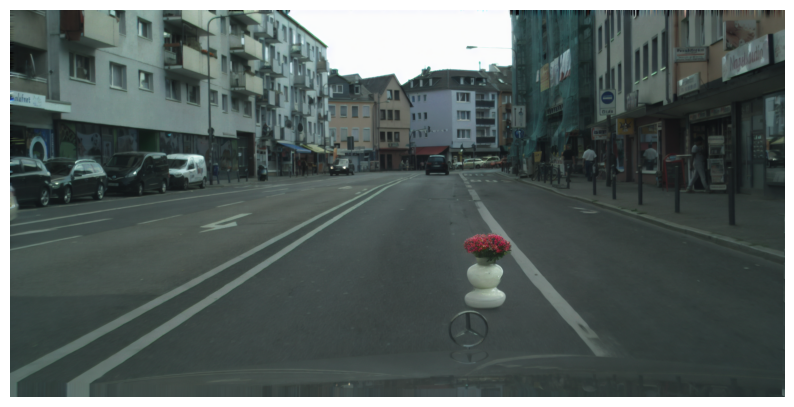

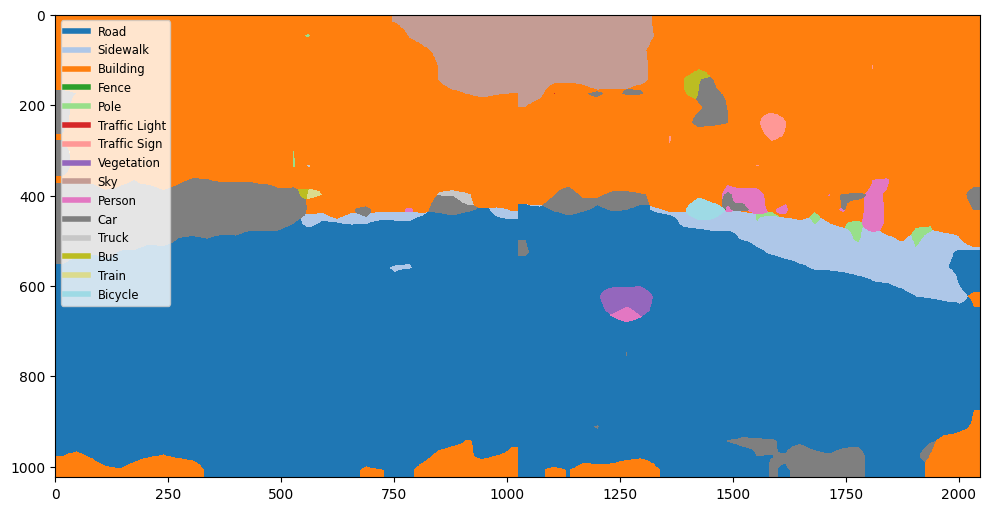

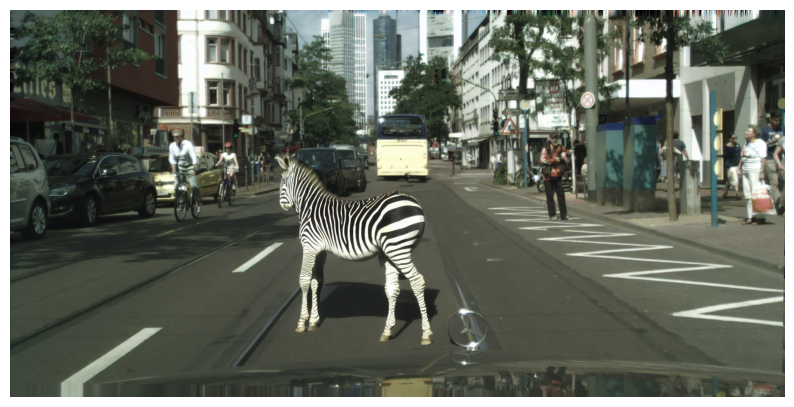

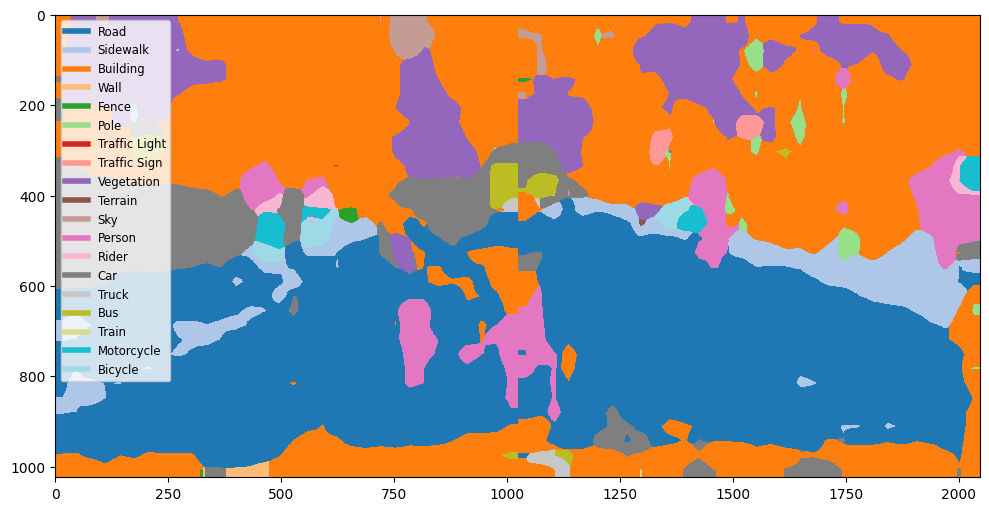

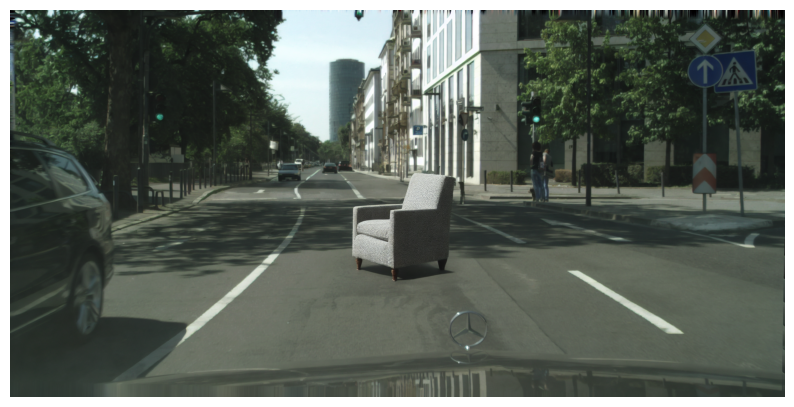

...

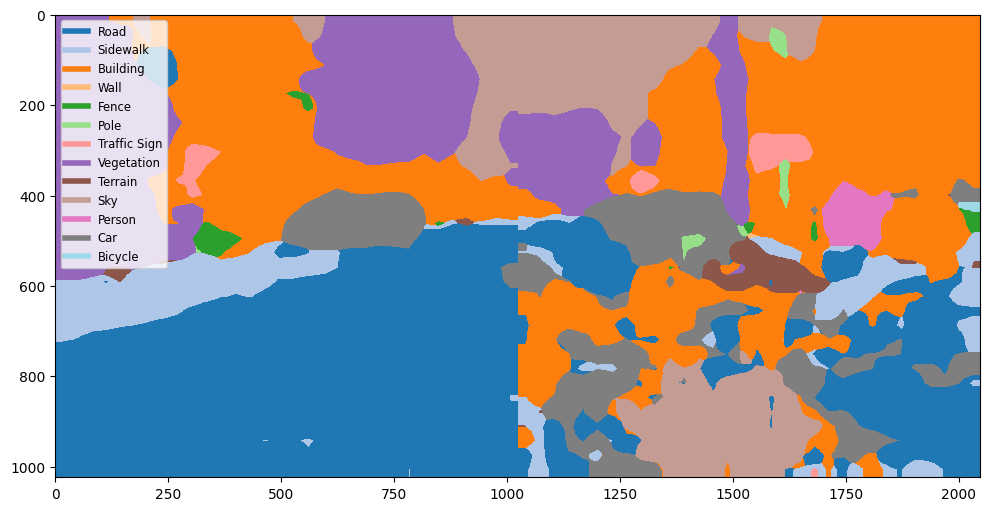

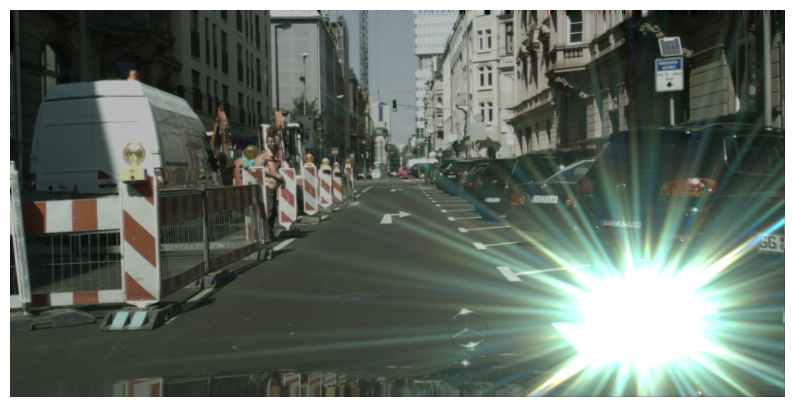

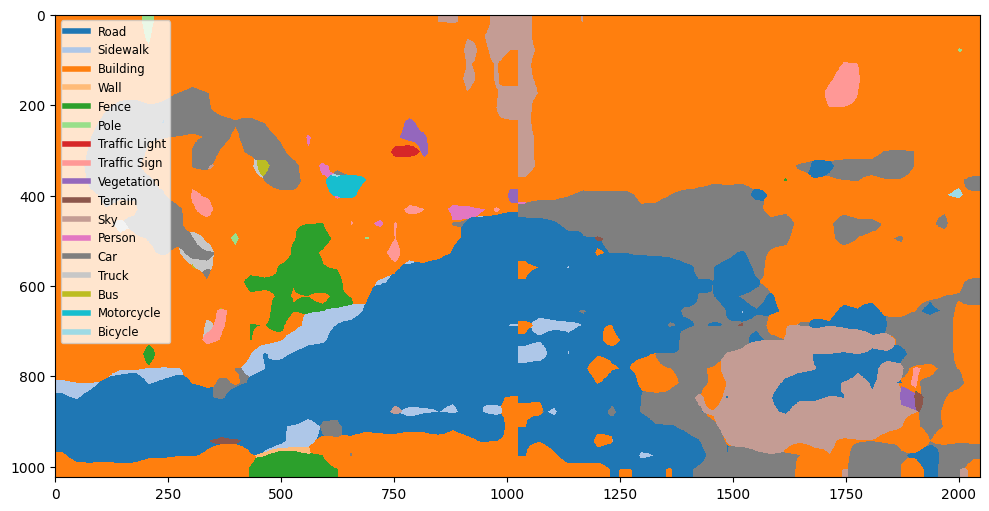

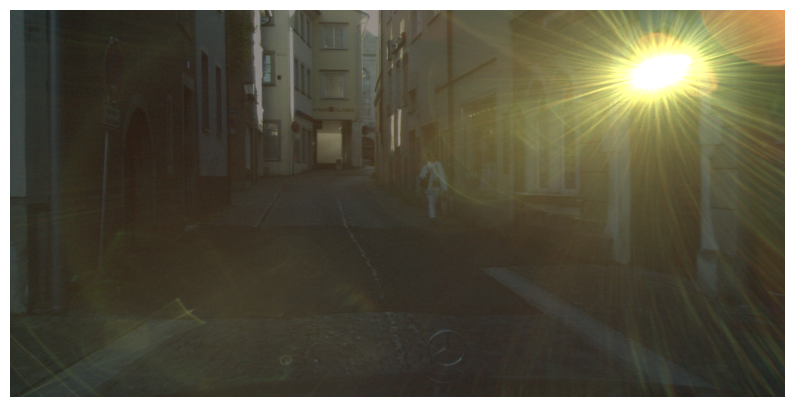

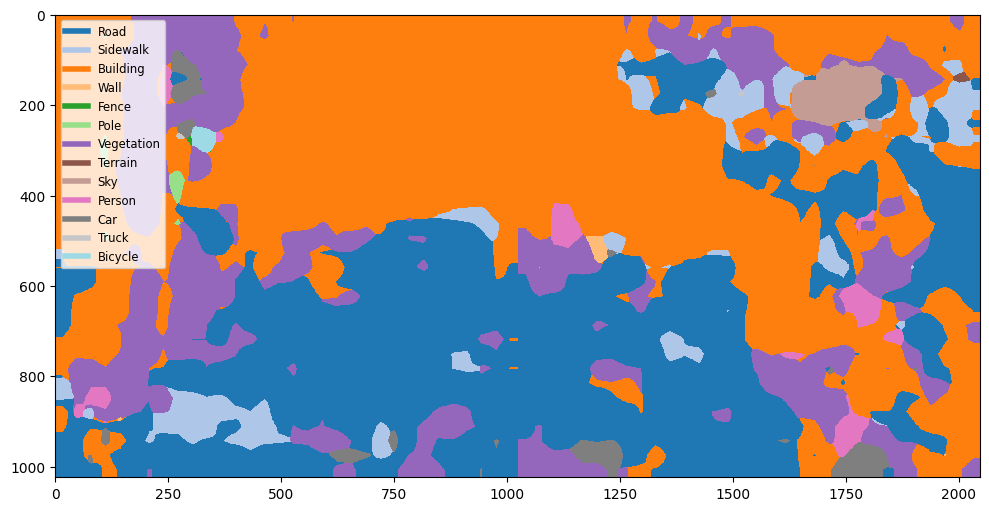

In [2]:
import os
from PIL import Image
import torch
import torch.nn.functional as F
from torchvision import tv_tensors
from torch.cuda.amp.autocast_mode import autocast
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.lines import Line2D
import numpy as np

# Cityscapes class names starting from "Road" (index 1)
class_names = [
    "Road",
    "Sidewalk",
    "Building",
    "Wall",
    "Fence",
    "Pole",
    "Traffic Light",
    "Traffic Sign",
    "Vegetation",
    "Terrain",
    "Sky",
    "Person",
    "Rider",
    "Car",
    "Truck",
    "Bus",
    "Train",
    "Motorcycle",
    "Bicycle",
]


def plot_predictions(img, logits, cmap="tab20"):
    fig, ax = plt.subplots(figsize=[10, 8])

    preds = torch.argmax(logits, dim=0).cpu().numpy()
    unique_classes = np.unique(preds)

    # Predefine colors for each class
    colors = plt.get_cmap(cmap)(np.linspace(0, 1, len(class_names)))

    # Create a color map for all classes
    custom_cmap = mcolors.ListedColormap(colors[: len(class_names)])
    norm = mcolors.BoundaryNorm(
        boundaries=np.arange(len(class_names) + 1) - 0.5, ncolors=len(class_names)
    )

    # Plot the predictions
    ax.imshow(preds, cmap=custom_cmap, norm=norm, interpolation="nearest")

    # Create the legend only for classes present in the image
    patches = []
    for class_idx in unique_classes:
        class_label = class_names[class_idx]
        color = colors[class_idx]
        patches.append(Line2D([0], [0], color=color, lw=4, label=class_label))

    plt.legend(handles=patches, loc="upper left", fontsize="small")

    plt.tight_layout()
    plt.show()


def plot_image(img):
    plt.figure(figsize=[10, 8])  # Larger figure size for better visibility
    img_np = img.cpu().numpy().transpose(1, 2, 0)
    plt.imshow(img_np)
    plt.axis("off")
    plt.show()


model.eval()

image_dir = "/mnt/sda1/tkerssies/bravo_1.0"
folders_processed = set()

for root, dirs, files in os.walk(image_dir):
    folder_name = os.path.basename(root)
    if folder_name not in folders_processed:
        for img_name in files:
            img_path = os.path.join(root, img_name)

            if img_path.lower().endswith((".png", ".jpg", ".jpeg")):
                img = Image.open(img_path).convert("RGB")
                img_tensor = tv_tensors.Image(img).to(device)

                with torch.no_grad():
                    with autocast(dtype=torch.float16):
                        crops, origins, img_sizes = model.window_imgs_semantic(
                            [img_tensor]
                        )
                        crop_logits = model(crops)
                        crop_logits = F.interpolate(crop_logits, 1024, mode="bilinear")
                        logits = model.revert_window_logits_semantic(
                            crop_logits, origins, img_sizes
                        )

                # Plot the original image
                plot_image(img_tensor)

                # Plot the predictions
                plot_predictions(img_tensor, logits[0], cmap="tab20")

                folders_processed.add(folder_name)
                break  # Stop after processing the first image in the current folder

In [4]:
import os
from PIL import Image
import torch
import torch.nn.functional as F
from torchvision import tv_tensors
from torch.cuda.amp.autocast_mode import autocast
import numpy as np

model.eval()

image_dir = "/mnt/sda1/tkerssies/bravo_1.0"
output_dir = (
    "/mnt/sda1/tkerssies/zyu2bnvv"  # Change to the desired submission directory
)

for root, dirs, files in os.walk(image_dir):
    for img_name in files:
        img_path = os.path.join(root, img_name)

        if img_path.lower().endswith((".png", ".jpg", ".jpeg")):
            img = Image.open(img_path).convert("RGB")
            img_tensor = tv_tensors.Image(img).to(device)

            with torch.no_grad():
                with autocast(dtype=torch.float16):
                    crops, origins, img_sizes = model.window_imgs_semantic([img_tensor])
                    crop_logits = model(crops)
                    crop_logits = F.interpolate(
                        crop_logits, model.img_size, mode="bilinear"
                    )
                    logits = model.revert_window_logits_semantic(
                        crop_logits, origins, img_sizes
                    )

            # Generate predictions and confidences
            preds = torch.argmax(logits[0], dim=0).cpu().numpy().astype(np.uint8)
            confidences = (
                torch.max(torch.softmax(logits[0], dim=0), dim=0)[0].cpu().numpy()
            )
            confidences = (confidences * 65535).astype(np.uint16)  # Scale to 16-bit

            # Prepare output paths
            rel_dir = os.path.relpath(
                root, image_dir
            )  # Get relative directory to maintain structure
            save_dir = os.path.join(output_dir, rel_dir)
            os.makedirs(save_dir, exist_ok=True)

            base_name = os.path.splitext(img_name)[0]
            pred_path = os.path.join(save_dir, f"{base_name}_pred.png")
            conf_path = os.path.join(save_dir, f"{base_name}_conf.png")

            # Save predictions and confidences
            Image.fromarray(preds).save(pred_path)  
            Image.fromarray(confidences).save(conf_path)

print(f"Submission files created in {output_dir}")

TypeError: LightningModule.window_imgs_semantic() takes 2 positional arguments but 3 were given